In [1]:
#Get an ensemble of 3 classifiers and train them to predict

from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.datasets import make_moons
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


X, y = make_moons(n_samples=10000, noise=0.15)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

log_clf = LogisticRegression()
rnd_clf = RandomForestClassifier()
svm_clf = SVC()

voting_clf = VotingClassifier(
    estimators=[('lr', log_clf), ('rf', rnd_clf), ('svc', svm_clf)],
    voting='hard')
voting_clf.fit(X_train, y_train)


for clf in (log_clf, rnd_clf, svm_clf, voting_clf):
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    print(clf.__class__.__name__, accuracy_score(y_test, y_pred))


LogisticRegression 0.879
RandomForestClassifier 0.99
SVC 0.9925
VotingClassifier 0.99


In [2]:
#Same thing, but with soft voting (oftentimes better, but who knows, ya know?)
svm_clf_proba = SVC(probability=True)

voting_clf = VotingClassifier(
    estimators=[('lr', log_clf), ('rf', rnd_clf), ('svc', svm_clf_proba)],
    voting='soft')
voting_clf.fit(X_train, y_train)


for clf in (log_clf, rnd_clf, svm_clf, voting_clf):
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    print(clf.__class__.__name__, accuracy_score(y_test, y_pred))

LogisticRegression 0.879
RandomForestClassifier 0.99
SVC 0.9925
VotingClassifier 0.9895


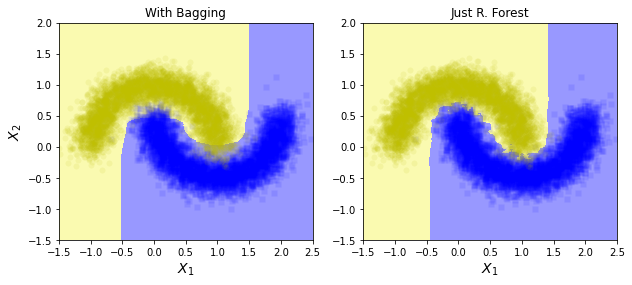

In [5]:
#Bagging with SciKit
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

#Auto soft-voting
bag_clf = BaggingClassifier(
    DecisionTreeClassifier(), n_estimators=500,
    max_samples=100, bootstrap=True, n_jobs=-1)
bag_clf.fit(X_train, y_train)
y_pred = bag_clf.predict(X_test)

fig = plt.figure(1, figsize=(10, 4))

x0, x1 = np.meshgrid(
    np.linspace(-1.5, 2.5, 1500).reshape(-1, 1),
    np.linspace(-1.5, 2.0, 1500).reshape(-1, 1), )
X_new = np.c_[x0.ravel(), x1.ravel()]

fig.add_subplot(121)
y_proba = bag_clf.predict_proba(X_new)
y_predict = bag_clf.predict(X_new)

zz1 = y_proba[:, 1].reshape(x0.shape)
zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')


custom_cmap = ListedColormap(
    ['#fafab0','#9898ff'])
plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.ylabel(r'$X_2$', fontsize=14)
plt.title("With Bagging")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 

fig.add_subplot(122)
y_proba = rnd_clf.predict_proba(X_new)
y_predict = rnd_clf.predict(X_new)

zz1 = y_proba[:, 1].reshape(x0.shape)
zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.title("Just R. Forest")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 
plt.show()


In [4]:
#Utilizing OOB
bag_clf = BaggingClassifier(
    DecisionTreeClassifier(), n_estimators=500,
    bootstrap=True, n_jobs=-1, oob_score=True)
bag_clf.fit(X_train, y_train)
print("Predicted OOB Score: "+str(bag_clf.oob_score_))

from sklearn.metrics import accuracy_score

y_pred = bag_clf.predict(X_test)
print("Actual Accuracy: "+str(accuracy_score(y_test, y_pred)))
print("What's the OOB decision function look like?\n"+str(bag_clf.oob_decision_function_))


Predicted OOB Score: 0.98925
Actual Accuracy: 0.9895
What's the OOB decision function look like?
[[0.         1.        ]
 [1.         0.        ]
 [0.         1.        ]
 ...
 [0.05102041 0.94897959]
 [1.         0.        ]
 [0.         1.        ]]


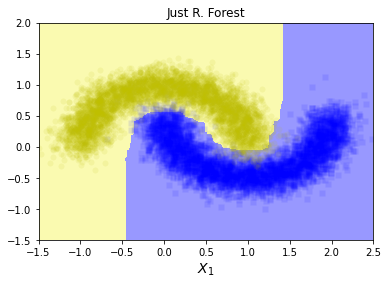

In [7]:
#Using the random forest
#BaggingClassifier meets DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

rnd_clf = RandomForestClassifier(n_estimators=500, max_leaf_nodes=16, n_jobs=-1)
#Or the bagging classifier equivalent
# bag_clf = BaggingClassifier(
#     DecisionTreeClassifier(splitter="random", max_leaf_nodes=16),
#     n_estimators=500, max_samples=1.0, bootstrap=True, n_jobs=-1)

rnd_clf.fit(X_train, y_train)

y_pred_rf = rnd_clf.predict(X_test)

y_proba = rnd_clf.predict_proba(X_new)
y_predict = rnd_clf.predict(X_new)

zz1 = y_proba[:, 1].reshape(x0.shape)
zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.axis([-1.5, 2.5, -1.5, 2.0]) 
plt.show()

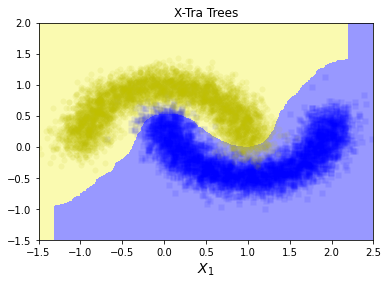

In [9]:
#Extra trees!
from sklearn.ensemble import ExtraTreesClassifier

x_rnd_clf = ExtraTreesClassifier(n_estimators=500, max_leaf_nodes=16, n_jobs=-1)

x_rnd_clf.fit(X_train, y_train)

y_pred_rf = x_rnd_clf.predict(X_test)

y_proba = x_rnd_clf.predict_proba(X_new)
y_predict = x_rnd_clf.predict(X_new)

zz1 = y_proba[:, 1].reshape(x0.shape)
zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.title("X-Tra Trees")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 
plt.show()

In [10]:
#Determining importance of features using the RF
from sklearn.datasets import load_iris

iris = load_iris()
rnd_clf = RandomForestClassifier(n_estimators=500, n_jobs=-1)
rnd_clf.fit(iris["data"], iris["target"])
for name, score in zip(iris["feature_names"], rnd_clf.feature_importances_):
    print(name, score)

sepal length (cm) 0.10373853116484803
sepal width (cm) 0.02387677790536691
petal length (cm) 0.43451528575454507
petal width (cm) 0.4378694051752399


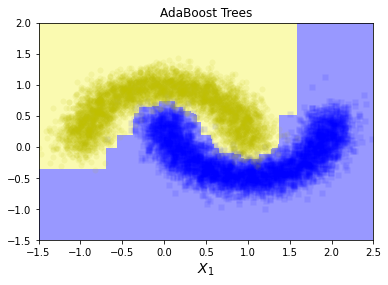

In [12]:
#Adaboost tree
from sklearn.ensemble import AdaBoostClassifier

ada_clf = AdaBoostClassifier(
    DecisionTreeClassifier(max_depth=1), n_estimators=200,
    algorithm="SAMME.R", learning_rate=0.5)
ada_clf.fit(X_train, y_train)

y_pred_rf = ada_clf.predict(X_test)

y_proba = ada_clf.predict_proba(X_new)
y_predict = ada_clf.predict(X_new)

zz1 = y_proba[:, 1].reshape(x0.shape)
zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.title("AdaBoost Trees")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 
plt.show()

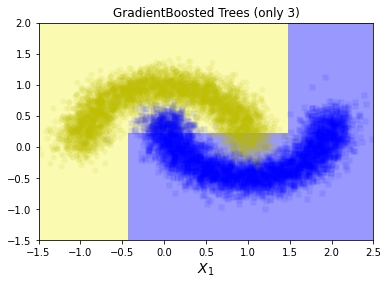

In [14]:
#Gradient Boosted Regression Trees (GBRT)
from sklearn.tree import DecisionTreeRegressor

tree_reg1 = DecisionTreeRegressor(max_depth=2)
tree_reg1.fit(X, y)

y2 = y - tree_reg1.predict(X)
tree_reg2 = DecisionTreeRegressor(max_depth=2)
tree_reg2.fit(X, y2)

y3 = y2 - tree_reg2.predict(X)
tree_reg3 = DecisionTreeRegressor(max_depth=2)
tree_reg3.fit(X, y3)

y_pred_rf = sum(tree.predict(X_test) for tree in (tree_reg1, tree_reg2, tree_reg3))

y_predict = sum(tree.predict(X_new) for tree in (tree_reg1, tree_reg2, tree_reg3))

zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.title("GradientBoosted Trees (only 3)")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 
plt.show()

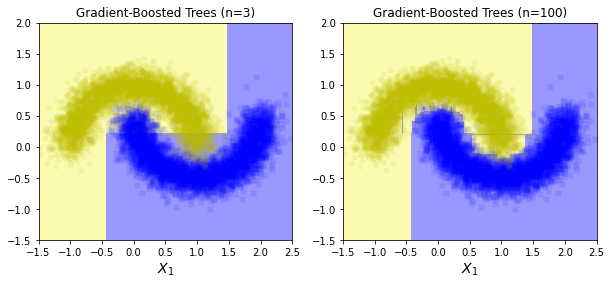

In [19]:
#Scikit's Gradient Booster
from sklearn.ensemble import GradientBoostingRegressor

fig = plt.figure(1, figsize=(10, 4))
fig.add_subplot(121)
gbrt = GradientBoostingRegressor(max_depth=2, n_estimators=3, learning_rate=1.0)
gbrt.fit(X, y)

y_pred_rf = gbrt.predict(X_test)

y_predict = gbrt.predict(X_new)

zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.title("Gradient-Boosted Trees (n=3)")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 

fig.add_subplot(122)
gbrt = GradientBoostingRegressor(max_depth=2, n_estimators=100, learning_rate=1.0)
gbrt.fit(X, y)

y_pred_rf = gbrt.predict(X_test)

y_predict = gbrt.predict(X_new)

zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.title("Gradient-Boosted Trees (n=100)")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 
plt.show()

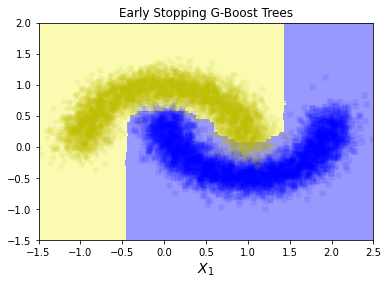

In [23]:
#G-Boosting to find optimal tree number (early stopping)
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

X_train, X_val, y_train, y_val = train_test_split(X, y)
gbrt = GradientBoostingRegressor(max_depth=2, n_estimators=120)
gbrt.fit(X_train, y_train)
errors = [mean_squared_error(y_val, y_pred) for y_pred in gbrt.staged_predict(X_val)]

bst_n_estimators = np.argmin(errors) + 1

gbrt_best = GradientBoostingRegressor(max_depth=2,n_estimators=bst_n_estimators)
gbrt_best.fit(X_train, y_train)

y_pred_rf = gbrt_best.predict(X_test)

y_predict = gbrt_best.predict(X_new)

zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.title("Early Stopping G-Boost Trees")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 
plt.show()

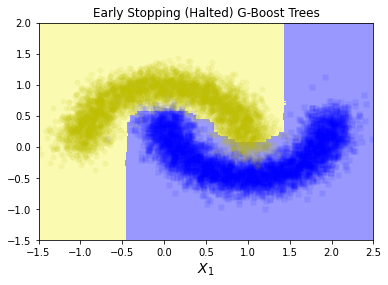

In [24]:
#Early stopping by actually halting training (instead of just picking the best)
gbrt = GradientBoostingRegressor(max_depth=2, warm_start=True)

min_val_error = float("inf")
error_going_up = 0
for n_estimators in range(1, 120):
    gbrt.n_estimators = n_estimators
    gbrt.fit(X_train, y_train)
    y_pred = gbrt.predict(X_val)
    val_error = mean_squared_error(y_val, y_pred)
    if val_error < min_val_error:
        min_val_error = val_error
        error_going_up = 0
    else:
        error_going_up += 1
        if error_going_up == 5:
            break # early stopping

y_pred_rf = gbrt.predict(X_test)

y_predict = gbrt.predict(X_new)

zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.title("Early Stopping (Halted) G-Boost Trees")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 
plt.show()

[0]	validation_0-rmse:0.35674
[1]	validation_0-rmse:0.25820
[2]	validation_0-rmse:0.19280
[3]	validation_0-rmse:0.15048
[4]	validation_0-rmse:0.12397
[5]	validation_0-rmse:0.10961
[6]	validation_0-rmse:0.10210
[7]	validation_0-rmse:0.09726
[8]	validation_0-rmse:0.09584
[9]	validation_0-rmse:0.09523
[10]	validation_0-rmse:0.09469
[11]	validation_0-rmse:0.09426
[12]	validation_0-rmse:0.09402
[13]	validation_0-rmse:0.09404
[14]	validation_0-rmse:0.09376
[15]	validation_0-rmse:0.09416
[16]	validation_0-rmse:0.09370
[17]	validation_0-rmse:0.09344
[18]	validation_0-rmse:0.09376
[19]	validation_0-rmse:0.09376


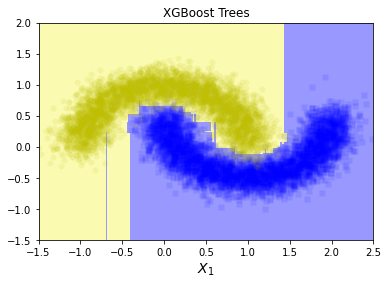

In [27]:
#XGBOOST (Xtreme Boosting)
import xgboost

xgb_reg = xgboost.XGBRegressor()
xgb_reg.fit(X_train, y_train)
y_pred = xgb_reg.predict(X_val)

xgb_reg.fit(X_train, y_train,
    eval_set=[(X_val, y_val)], early_stopping_rounds=2)
y_pred = xgb_reg.predict(X_val)

y_pred_rf = xgb_reg.predict(X_test)

y_predict = xgb_reg.predict(X_new)

zz = y_predict.reshape(x0.shape) 

plt.plot(X[y==1, 0], X[y==1, 1], "bs", alpha=0.1, markeredgecolor='none')
plt.plot(X[y==0, 0], X[y==0, 1], "yo", alpha=0.1, markeredgecolor='none')

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel(r'$X_1$', fontsize=14)
plt.title("XGBoost Trees")
plt.axis([-1.5, 2.5, -1.5, 2.0]) 
plt.show()

In [ ]:
#Stacking is hard